### My public kernel: https://www.kaggle.com/podsyp/regression-with-categorical-data-starter-pack

# Regression with categorical data starter pack

## Introduction
Greetings from the Kaggle bot! This is an automatically-generated kernel with starter code demonstrating how to read in the data and begin exploring. If you're inspired to dig deeper, click the blue "Fork Notebook" button at the top of this kernel to begin editing.

## Exploratory Analysis
To begin this exploratory analysis, first import libraries and define functions for plotting the data using matplotlib. Depending on the data, not all plots will be made. (Hey, I'm just a simple kerneling bot, not a Kaggle Competitions Grandmaster!)

# Some import

In [1]:
import os # accessing directory structure
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/regression-with-categorical-data/test.csv
/kaggle/input/regression-with-categorical-data/train.csv


In [2]:
import numpy as np 
import pandas as pd 
import pandas_profiling
import pandas_summary as ps
import shap


# Data processing, metrics and modeling
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold
from sklearn.decomposition import PCA
import collections

# Lgbm
import lightgbm as lgb

# Hyper_opt
from hyperopt import hp
from hyperopt import fmin, tpe, Trials, space_eval, STATUS_OK, STATUS_RUNNING
import hyperopt.pyll
from hyperopt.pyll import scope

# Suppr warning
import warnings
warnings.filterwarnings("ignore")

# Plots
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import rcParams

# Others
import shap
import datetime
from tqdm import tqdm_notebook
import sys
import pickle
import re
import json

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 1000)
pd.set_option('display.width', 1000)
pd.set_option('use_inf_as_na', True)

warnings.simplefilter('ignore')
matplotlib.rcParams['figure.dpi'] = 100
sns.set()
%matplotlib inline

### Immediately, do the right thing. Reduce the amount of memory under the data frame when reading.

In [3]:
def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.        
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))
    
    for col in df.columns:
        col_type = df[col].dtype
        
        if col_type != object:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
        else:
            df[col] = df[col].astype('category')

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    
    return df

In [4]:
train_df = reduce_mem_usage(pd.read_csv('../input/regression-with-categorical-data/train.csv'))
test_df = reduce_mem_usage(pd.read_csv('../input/regression-with-categorical-data/test.csv'))

Memory usage of dataframe is 170.69 MB
Memory usage after optimization is: 24.94 MB
Decreased by 85.4%
Memory usage of dataframe is 18.82 MB
Memory usage after optimization is: 2.72 MB
Decreased by 85.5%


Good optimization

## EDA

In [5]:
train_df.shape, test_df.shape

((169486, 132), (18832, 131))

## With this amount, you can use gradient boosting.

In [6]:
train_df.head()

,id,col_1,col_2,col_3,col_4,col_5,col_6,col_7,col_8,col_9,col_10,col_11,col_12,col_13,col_14,col_15,col_16,col_17,col_18,col_19,col_20,col_21,col_22,col_23,col_24,col_25,col_26,col_27,col_28,col_29,col_30,col_31,col_32,col_33,col_34,col_35,col_36,col_37,col_38,col_39,col_40,col_41,col_42,col_43,col_44,col_45,col_46,col_47,col_48,col_49,col_50,col_51,col_52,col_53,col_54,col_55,col_56,col_57,col_58,col_59,col_60,col_61,col_62,col_63,col_64,col_65,col_66,col_67,col_68,col_69,col_70,col_71,col_72,col_73,col_74,col_75,col_76,col_77,col_78,col_79,col_80,col_81,col_82,col_83,col_84,col_85,col_86,col_87,col_88,col_89,col_90,col_91,col_92,col_93,col_94,col_95,col_96,col_97,col_98,col_99,col_100,col_101,col_102,col_103,col_104,col_105,col_106,col_107,col_108,col_109,col_110,col_111,col_112,col_113,col_114,col_115,col_116,col_117,col_118,col_119,col_120,col_121,col_122,col_123,col_124,col_125,col_126,col_127,col_128,col_129,col_130,target
0,2,A,B,A,A,A,A,A,A,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,D,B,B,D,D,A,B,C,B,D,B,A,A,A,A,A,D,D,C,E,E,D,T,L,F,A,A,E,E,I,K,K,BI,CQ,A,AV,BM,A,O,DP,0.330566,0.737305,0.592773,0.614258,0.885742,0.438965,0.436523,0.601074,0.351318,0.439209,0.338379,0.366211,0.611328,0.304443,1283.599976
1,5,A,B,A,A,B,A,A,A,B,B,B,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,D,B,B,B,D,B,D,C,B,B,B,A,A,A,A,A,D,D,C,E,E,A,D,L,O,A,B,E,F,H,F,A,AB,DK,A,C,AF,A,I,GK,0.261963,0.358398,0.484131,0.236938,0.396973,0.289551,0.315430,0.273193,0.260742,0.324463,0.381348,0.373535,0.195679,0.774414,3005.090088
2,10,B,B,A,B,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,D,B,B,D,D,D,B,C,B,D,B,A,A,A,A,A,D,D,C,E,E,D,T,I,D,A,A,E,E,I,K,K,BI,CS,C,N,AE,A,O,DJ,0.321533,0.555664,0.527832,0.373779,0.422363,0.440918,0.391113,0.317871,0.321289,0.444580,0.327881,0.321533,0.604980,0.602539,939.849976
3,11,A,B,A,B,A,A,A,A,B,B,A,B,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,D,B,D,B,D,B,B,C,B,B,C,A,A,A,B,H,D,B,D,E,E,A,P,F,J,A,A,D,E,K,G,B,H,C,C,Y,BM,A,K,CK,0.273193,0.160034,0.527832,0.473145,0.704102,0.178223,0.247437,0.245605,0.220947,0.212280,0.204712,0.202271,0.245972,0.432617,2763.850098
4,13,A,B,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,D,B,D,B,D,B,B,C,B,B,B,A,A,A,A,A,D,D,D,E,C,A,P,J,D,A,A,E,E,H,F,B,BI,CS,A,AS,AE,A,K,DJ,0.546875,0.681641,0.634277,0.373779,0.302734,0.364502,0.401123,0.268555,0.462158,0.505371,0.366699,0.359131,0.345215,0.726562,5142.870117


In [7]:
train_df.tail()

,id,col_1,col_2,col_3,col_4,col_5,col_6,col_7,col_8,col_9,col_10,col_11,col_12,col_13,col_14,col_15,col_16,col_17,col_18,col_19,col_20,col_21,col_22,col_23,col_24,col_25,col_26,col_27,col_28,col_29,col_30,col_31,col_32,col_33,col_34,col_35,col_36,col_37,col_38,col_39,col_40,col_41,col_42,col_43,col_44,col_45,col_46,col_47,col_48,col_49,col_50,col_51,col_52,col_53,col_54,col_55,col_56,col_57,col_58,col_59,col_60,col_61,col_62,col_63,col_64,col_65,col_66,col_67,col_68,col_69,col_70,col_71,col_72,col_73,col_74,col_75,col_76,col_77,col_78,col_79,col_80,col_81,col_82,col_83,col_84,col_85,col_86,col_87,col_88,col_89,col_90,col_91,col_92,col_93,col_94,col_95,col_96,col_97,col_98,col_99,col_100,col_101,col_102,col_103,col_104,col_105,col_106,col_107,col_108,col_109,col_110,col_111,col_112,col_113,col_114,col_115,col_116,col_117,col_118,col_119,col_120,col_121,col_122,col_123,col_124,col_125,col_126,col_127,col_128,col_129,col_130,target
169481,587620,A,B,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,B,A,A,A,D,B,C,B,D,B,B,C,B,B,B,A,A,A,A,A,D,D,D,E,E,A,P,I,D,A,A,D,E,J,G,B,BI,EG,A,G,BM,A,L,CK,0.347412,0.785645,0.613770,0.473145,0.939453,0.242432,0.290039,0.245605,0.308594,0.329346,0.223022,0.219971,0.333252,0.208252,1198.619995
169482,587624,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,D,B,B,D,D,B,A,C,B,B,B,A,A,A,A,A,D,D,D,E,C,A,P,K,A,A,A,E,E,H,F,B,BI,BT,A,AV,AU,E,J,DF,0.507812,0.555664,0.549805,0.802734,0.704102,0.334229,0.382080,0.634766,0.404541,0.477783,0.307617,0.302002,0.318604,0.305908,1108.339966
169483,587630,A,B,A,A,A,A,A,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,D,B,D,B,C,B,A,C,B,B,B,A,A,A,B,H,D,D,D,E,C,A,P,F,C,C,A,E,F,H,F,B,BI,DM,A,W,AF,A,K,DJ,0.484375,0.785645,0.792480,0.189087,0.482422,0.345947,0.370605,0.245605,0.458008,0.477783,0.445557,0.443359,0.339355,0.503906,5762.640137
169484,587632,A,B,A,A,A,A,A,A,B,B,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,D,B,A,D,D,A,B,C,B,D,B,A,A,A,A,A,C,D,C,E,C,D,T,L,J,A,A,K,G,F,J,K,BI,AI,A,AS,AJ,A,O,MD,0.438477,0.422119,0.299072,0.383545,0.340576,0.704590,0.562988,0.349854,0.447754,0.538574,0.863281,0.853027,0.654785,0.721680,1562.869995
169485,587633,B,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,B,A,B,B,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,D,B,B,D,D,B,B,C,B,D,B,A,A,A,E,B,D,D,C,E,A,C,T,I,A,A,A,L,H,F,G,G,BI,EG,K,AS,AD,A,O,MJ,0.907227,0.620605,0.440674,0.821777,0.281250,0.844727,0.533203,0.971191,0.933594,0.838379,0.932129,0.946289,0.810547,0.721680,4751.720215


In [8]:
test_df.head()

,id,col_1,col_2,col_3,col_4,col_5,col_6,col_7,col_8,col_9,col_10,col_11,col_12,col_13,col_14,col_15,col_16,col_17,col_18,col_19,col_20,col_21,col_22,col_23,col_24,col_25,col_26,col_27,col_28,col_29,col_30,col_31,col_32,col_33,col_34,col_35,col_36,col_37,col_38,col_39,col_40,col_41,col_42,col_43,col_44,col_45,col_46,col_47,col_48,col_49,col_50,col_51,col_52,col_53,col_54,col_55,col_56,col_57,col_58,col_59,col_60,col_61,col_62,col_63,col_64,col_65,col_66,col_67,col_68,col_69,col_70,col_71,col_72,col_73,col_74,col_75,col_76,col_77,col_78,col_79,col_80,col_81,col_82,col_83,col_84,col_85,col_86,col_87,col_88,col_89,col_90,col_91,col_92,col_93,col_94,col_95,col_96,col_97,col_98,col_99,col_100,col_101,col_102,col_103,col_104,col_105,col_106,col_107,col_108,col_109,col_110,col_111,col_112,col_113,col_114,col_115,col_116,col_117,col_118,col_119,col_120,col_121,col_122,col_123,col_124,col_125,col_126,col_127,col_128,col_129,col_130
0,1,A,B,A,B,A,A,A,A,B,A,B,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,D,B,B,D,D,B,D,C,B,D,B,A,A,A,A,A,D,B,C,E,A,C,T,B,G,A,A,I,E,G,J,G,BU,BC,C,AS,S,A,O,LB,0.726074,0.245972,0.187622,0.789551,0.310059,0.718262,0.334961,0.302490,0.671387,0.834961,0.569824,0.594727,0.822266,0.714844
1,25,A,B,A,A,A,A,A,A,B,B,B,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,D,B,B,D,D,B,B,A,B,B,B,A,A,A,G,H,D,D,D,E,A,A,P,H,Q,A,A,F,G,G,F,D,BI,AM,A,AS,H,A,K,GS,0.496094,0.358398,0.654297,0.283936,0.281250,0.429443,0.877930,0.394531,0.535645,0.505371,0.550293,0.538574,0.336182,0.714844
2,57,B,B,A,B,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,D,B,B,D,D,D,B,C,B,D,B,A,A,A,A,A,D,D,C,E,E,D,T,I,D,A,A,E,E,I,K,K,BI,CS,C,F,AE,A,O,DJ,0.338379,0.785645,0.654297,0.373779,0.718750,0.441406,0.437256,0.317871,0.321289,0.444580,0.377686,0.369873,0.604980,0.743652
3,100,B,B,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,D,B,B,B,D,B,B,C,B,D,D,A,A,A,A,A,D,D,C,E,C,D,T,J,C,A,A,G,F,G,J,K,BI,CO,A,N,AX,A,N,HK,0.452637,0.488770,0.549805,0.432617,0.281250,0.577148,0.582520,0.656738,0.483154,0.577148,0.625977,0.612793,0.617676,0.598633
4,140,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,B,A,A,A,D,B,B,D,D,B,B,C,B,B,B,A,A,A,A,A,D,D,A,E,C,A,F,I,A,A,A,F,E,E,F,A,BI,W,A,I,F,E,J,GS,0.347412,0.422119,0.613770,0.383545,0.372314,0.590332,0.864258,0.524414,0.347412,0.334229,0.531250,0.519531,0.253418,0.295166


In [9]:
test_df.tail()

,id,col_1,col_2,col_3,col_4,col_5,col_6,col_7,col_8,col_9,col_10,col_11,col_12,col_13,col_14,col_15,col_16,col_17,col_18,col_19,col_20,col_21,col_22,col_23,col_24,col_25,col_26,col_27,col_28,col_29,col_30,col_31,col_32,col_33,col_34,col_35,col_36,col_37,col_38,col_39,col_40,col_41,col_42,col_43,col_44,col_45,col_46,col_47,col_48,col_49,col_50,col_51,col_52,col_53,col_54,col_55,col_56,col_57,col_58,col_59,col_60,col_61,col_62,col_63,col_64,col_65,col_66,col_67,col_68,col_69,col_70,col_71,col_72,col_73,col_74,col_75,col_76,col_77,col_78,col_79,col_80,col_81,col_82,col_83,col_84,col_85,col_86,col_87,col_88,col_89,col_90,col_91,col_92,col_93,col_94,col_95,col_96,col_97,col_98,col_99,col_100,col_101,col_102,col_103,col_104,col_105,col_106,col_107,col_108,col_109,col_110,col_111,col_112,col_113,col_114,col_115,col_116,col_117,col_118,col_119,col_120,col_121,col_122,col_123,col_124,col_125,col_126,col_127,col_128,col_129,col_130
18827,587514,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,B,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,B,A,D,B,D,B,B,B,C,A,B,B,C,A,A,A,C,A,D,B,D,E,C,A,P,G,A,A,A,F,G,H,F,B,N,CV,G,E,BM,A,J,GS,0.465576,0.078369,0.484131,0.383545,0.281250,0.300293,0.331299,0.360840,0.360840,0.364502,0.430176,0.443359,0.269043,0.823242
18828,587541,A,A,A,A,A,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,D,B,B,D,D,B,B,C,B,B,B,A,B,A,A,A,D,D,D,E,A,A,P,K,A,A,A,F,F,G,F,B,BI,CO,A,E,X,E,K,GC,0.638672,0.555664,0.549805,0.833008,0.836426,0.482422,0.429688,0.672852,0.519043,0.604004,0.464844,0.481201,0.407715,0.801758
18829,587566,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,B,B,A,A,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,B,A,A,A,D,B,B,D,D,B,B,C,B,C,B,A,A,A,A,A,D,D,E,E,G,E,R,O,A,A,A,G,F,F,I,F,BI,CO,K,U,AE,A,N,HK,0.642578,0.488770,0.549805,0.327393,0.422363,0.688477,0.490479,0.339111,0.625488,0.730957,0.622070,0.609375,0.687012,0.342041
18830,587580,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,B,A,B,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,B,A,A,B,D,B,B,D,D,B,B,A,B,D,B,A,A,A,G,H,D,D,C,E,A,D,T,I,A,A,A,G,F,E,J,K,BI,CL,I,E,BN,A,N,HQ,0.447021,0.620605,0.710938,0.422607,0.850098,0.835938,0.794434,0.530273,0.508301,0.675781,0.742676,0.729980,0.663574,0.804688
18831,587611,A,B,A,A,B,A,A,A,B,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,A,B,A,A,A,A,D,B,B,D,D,B,B,C,B,B,B,A,A,A,A,A,D,B,D,E,E,A,P,G,F,A,B,C,E,K,H,B,K,EB,A,J,AE,A,L,CI,0.289551,0.358398,0.506348,0.354980,0.302734,0.186279,0.317383,0.278076,0.321289,0.243530,0.180420,0.178711,0.304443,0.381592


Using pandas_summary we’ll see describe the columns. By the way, here you can immediately see if reduce_mem_usage worked correctly, in some cases it gives inf ... If something went wrong, then the infs will appear in min and max.

In [10]:
dfs = ps.DataFrameSummary(train_df)
print('categoricals: ', dfs.categoricals.tolist())
print('numerics: ', dfs.numerics.tolist())
dfs.summary()

categoricals:  ['col_73', 'col_74', 'col_75', 'col_76', 'col_77', 'col_78', 'col_79', 'col_80', 'col_81', 'col_82', 'col_83', 'col_84', 'col_85', 'col_86', 'col_87', 'col_88', 'col_89', 'col_90', 'col_91', 'col_92', 'col_93', 'col_94', 'col_95', 'col_96', 'col_97', 'col_98', 'col_99', 'col_100', 'col_101', 'col_102', 'col_103', 'col_104', 'col_105', 'col_106', 'col_107', 'col_108', 'col_109', 'col_110', 'col_111', 'col_112', 'col_113', 'col_114', 'col_115', 'col_116']
numerics:  ['id', 'col_117', 'col_118', 'col_119', 'col_120', 'col_121', 'col_122', 'col_123', 'col_124', 'col_125', 'col_126', 'col_127', 'col_128', 'col_129', 'col_130', 'target']


,id,col_1,col_2,col_3,col_4,col_5,col_6,col_7,col_8,col_9,col_10,col_11,col_12,col_13,col_14,col_15,col_16,col_17,col_18,col_19,col_20,col_21,col_22,col_23,col_24,col_25,col_26,col_27,col_28,col_29,col_30,col_31,col_32,col_33,col_34,col_35,col_36,col_37,col_38,col_39,col_40,col_41,col_42,col_43,col_44,col_45,col_46,col_47,col_48,col_49,col_50,col_51,col_52,col_53,col_54,col_55,col_56,col_57,col_58,col_59,col_60,col_61,col_62,col_63,col_64,col_65,col_66,col_67,col_68,col_69,col_70,col_71,col_72,col_73,col_74,col_75,col_76,col_77,col_78,col_79,col_80,col_81,col_82,col_83,col_84,col_85,col_86,col_87,col_88,col_89,col_90,col_91,col_92,col_93,col_94,col_95,col_96,col_97,col_98,col_99,col_100,col_101,col_102,col_103,col_104,col_105,col_106,col_107,col_108,col_109,col_110,col_111,col_112,col_113,col_114,col_115,col_116,col_117,col_118,col_119,col_120,col_121,col_122,col_123,col_124,col_125,col_126,col_127,col_128,col_129,col_130,target
count,169486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,169486,169486,169486,169486,169486,169486,169486,169486,169486,169486,169486,169486,169486,169486,169486
mean,294137,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3043.99
std,169336,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2917.92
min,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5974e-05,0.00114918,0.00263405,0.17688,0.28125,0.0126801,0.069519,0.236938,7.99894e-05,0,0.0353088,0.0362244,0.000228047,0.179688,0.67
25%,147749,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.346191,0.358398,0.336914,0.327393,0.28125,0.336182,0.350098,0.312744,0.358887,0.364502,0.311035,0.314941,0.315674,0.294678,1204.4
50%,294540,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [11]:
dfs = ps.DataFrameSummary(test_df)
print('categoricals: ', dfs.categoricals.tolist())
print('numerics: ', dfs.numerics.tolist())
dfs.summary()

categoricals:  ['col_73', 'col_74', 'col_76', 'col_77', 'col_78', 'col_79', 'col_80', 'col_81', 'col_82', 'col_83', 'col_84', 'col_85', 'col_86', 'col_87', 'col_88', 'col_89', 'col_90', 'col_91', 'col_92', 'col_93', 'col_94', 'col_95', 'col_96', 'col_97', 'col_98', 'col_99', 'col_100', 'col_101', 'col_102', 'col_103', 'col_104', 'col_105', 'col_106', 'col_107', 'col_108', 'col_109', 'col_110', 'col_111', 'col_112', 'col_113', 'col_114', 'col_115', 'col_116']
numerics:  ['id', 'col_117', 'col_118', 'col_119', 'col_120', 'col_121', 'col_122', 'col_123', 'col_124', 'col_125', 'col_126', 'col_127', 'col_128', 'col_129', 'col_130']


,id,col_1,col_2,col_3,col_4,col_5,col_6,col_7,col_8,col_9,col_10,col_11,col_12,col_13,col_14,col_15,col_16,col_17,col_18,col_19,col_20,col_21,col_22,col_23,col_24,col_25,col_26,col_27,col_28,col_29,col_30,col_31,col_32,col_33,col_34,col_35,col_36,col_37,col_38,col_39,col_40,col_41,col_42,col_43,col_44,col_45,col_46,col_47,col_48,col_49,col_50,col_51,col_52,col_53,col_54,col_55,col_56,col_57,col_58,col_59,col_60,col_61,col_62,col_63,col_64,col_65,col_66,col_67,col_68,col_69,col_70,col_71,col_72,col_73,col_74,col_75,col_76,col_77,col_78,col_79,col_80,col_81,col_82,col_83,col_84,col_85,col_86,col_87,col_88,col_89,col_90,col_91,col_92,col_93,col_94,col_95,col_96,col_97,col_98,col_99,col_100,col_101,col_102,col_103,col_104,col_105,col_106,col_107,col_108,col_109,col_110,col_111,col_112,col_113,col_114,col_115,col_116,col_117,col_118,col_119,col_120,col_121,col_122,col_123,col_124,col_125,col_126,col_127,col_128,col_129,col_130
count,18832,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18832,18832,18832,18832,18832,18832,18832,18832,18832,18832,18832,18832,18832,18832
mean,294125,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.493652,0.504883,0.499268,0.489746,0.485596,0.491943,0.485596,0.486328,0.485596,0.498779,0.493164,0.492676,0.494385,0.494385
std,169342,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.187622,0.207397,0.20105,0.210571,0.208496,0.205933,0.17749,0.199829,0.181641,0.186279,0.209351,0.209351,0.213135,0.222656
min,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5974e-05,0.00257111,0.00263405,0.17688,0.28125,0.0126801,0.069519,0.236938,7.99894e-05,0,0.0353088,0.0362244,0.000228047,0.180542
25%,147742,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.347412,0.358398,0.336914,0.327393,0.28125,0.336182,0.351562,0.312744,0.358887,0.364502,0.307617,0.30835,0.315674,0.294434
50%,294536,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

# Target:

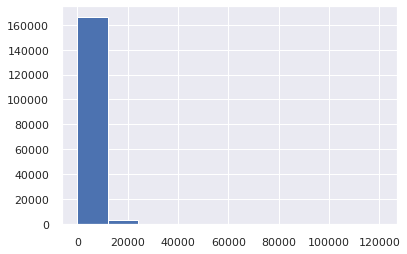

In [12]:
train_df['target'].hist();

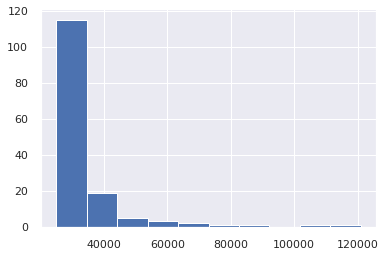

In [13]:
train_df[train_df['target']>25000]['target'].hist();

### Log it

In [14]:
train_df['target'] = np.log1p(train_df['target'])

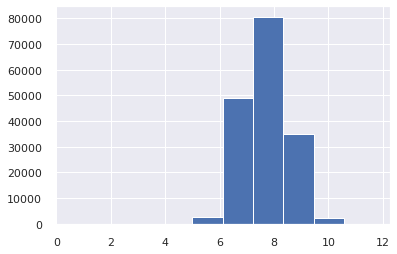

In [15]:
train_df['target'].hist();

In [16]:
y = train_df['target']
train_df.drop('target', axis=1, inplace=True)

## Much better!

In the id column, some insider is unlikely to be sewn up, we will drop. It’s more correct, of course, to index the data frame by id, but there is no task to build a pipeline, so we’ll omit this moment)

In [17]:
train_df.drop('id', axis=1, inplace=True)
test_df.drop('id', axis=1, inplace=True)

##### Let's check the columns in the test and train

In [18]:
train_df.columns.tolist() == test_df.columns.tolist()

True

## Let's look at the distributions, correlations, and other characteristics of the samples.

In [19]:
pandas_profiling.ProfileReport(train_df)

In [20]:
pandas_profiling.ProfileReport(test_df)

## Feature engineering will not do. Hypothesis - the number of features is excessive. We will look for top features and exclude those that negatively affect quality.

In [21]:
cat = train_df.select_dtypes(include=['category']).columns.tolist()

In [22]:
X_train, X_val, y_train, y_val = train_test_split(train_df, y, test_size=0.25, random_state=777)

## We will use more modern methods. We will choose hyperparameters as a hyperopt, and not a gridscaerch.

In [23]:
%%time
# Чем больше P, тем меньше мы хотим штрафовать за разницу между train  и test
p = 0.8
# k - количество итераций
k = 30

skf = KFold(n_splits=3, shuffle=True, random_state=7)

def score(params):
    print('Training with params:')
    print(params)
    w=[]
    best_iter = []
    

    for train_index, val_index in skf.split(X_train, y_train):
        x_train_1, x_valid_1 = X_train.iloc[train_index, :], X_train.iloc[val_index, :]
        y_train_1, y_valid_1 = y_train.iloc[train_index], y_train.iloc[val_index]
        train_data = lgb.Dataset(x_train_1, label=y_train_1, categorical_feature=cat)
        val_data = lgb.Dataset(x_valid_1, label=y_valid_1, categorical_feature=cat, reference=train_data)
        gbm = lgb.train(params,
                        train_data,
                        valid_sets = [train_data, val_data],
                        valid_names=['train', 'val'],
                        num_boost_round = 5000,
                        verbose_eval = False, 
                        categorical_feature=cat
                       )
        w.append([gbm.best_score['train']['rmse'], gbm.best_score['val']['rmse']])
        best_iter.append(gbm.best_iteration)
    nrounds = np.mean(best_iter)
    print('best iter:', int(nrounds), 'all iter:', best_iter)
    res = list(np.mean(w, axis=0))
    print("\t rmse train {0}, rmse test {1}, dif {2}, \n\t final score {3} \n\n".format(res[0], res[1], np.power(np.square(res[0]-res[1]), p), +res[1]+np.power(np.square(res[0]-res[1]), p)))
    return {'loss': +res[1]+np.power(np.square(res[0]-res[1]), p), 'status': STATUS_OK, 
            'mean_rmse_train': res[0], 'mean_rmse_test': res[1], 'best_iter': int(nrounds)}

def optimize(trials):
    space = {
        #'max_depth': hp.choice('max_depth', [-1, 6, 7]),
        'max_depth': -1,
        'max_bin': scope.int(hp.uniform('max_bin', 100, 2500)),
        'num_leaves': scope.int(hp.uniform('num_leaves', 20, 200)),
        'lambda_l1': hp.quniform('lambda_l1', 0, 8, 0.25),
        'learning_rate': hp.quniform('learning_rate', 0.01 , 0.05, 0.005),
        'bagging_fraction': hp.quniform('bagging_fraction', 0.3, 0.9, 0.1),
        'metric': ('rmse',),
        'boosting_type': 'gbdt',
        'objective': 'regression',
        'nthread': 8,
        'early_stopping_rounds': 20,
        'silent':1,
    }
    best = fmin(score, space, algo=tpe.suggest, trials=trials, max_evals=k)
    print(best)

trials = Trials()
optimize(trials)

Training with params:
{'bagging_fraction': 0.6000000000000001, 'boosting_type': 'gbdt', 'early_stopping_rounds': 20, 'lambda_l1': 4.5, 'learning_rate': 0.025, 'max_bin': 1830, 'max_depth': -1, 'metric': ('rmse',), 'nthread': 8, 'num_leaves': 107, 'objective': 'regression', 'silent': 1}
best iter:
382
all iter:
[405, 388, 355]
	 rmse train 0.4697412388629257, rmse test 0.5435193328928695, dif 0.015441301058618616, 
	 final score 0.5589606339514881 


Training with params:
{'bagging_fraction': 0.5, 'boosting_type': 'gbdt', 'early_stopping_rounds': 20, 'lambda_l1': 3.5, 'learning_rate': 0.05, 'max_bin': 1520, 'max_depth': -1, 'metric': ('rmse',), 'nthread': 8, 'num_leaves': 177, 'objective': 'regression', 'silent': 1}
best iter:
153
all iter:
[155, 155, 149]
	 rmse train 0.45650008993037966, rmse test 0.5450714948761984, dif 0.020685672941286044, 
	 final score 0.5657571678174845 


Training with params:
{'bagging_fraction': 0.4, 'boosting_type': 'gbdt', 'early_stopping_rounds': 20, 'lamb

# Let's train a model with selected hyperparameters.

In [24]:
params = trials.best_trial['misc']['vals']
params['max_depth'] = -1
params['boosting_type'] = 'gbdt'
params['objective'] = 'regression'
params['metric'] = ('l1', 'l2')
params['nthread'] = 8
params['early_stopping_rounds'] = 100
params['silent'] = 1
params['num_leaves'] = int(params['num_leaves'][0])
params['max_bin'] = int(params['max_bin'][0])
params

{'bagging_fraction': [0.8],
 'lambda_l1': [6.25],
 'learning_rate': [0.015],
 'max_bin': 860,
 'num_leaves': 21,
 'max_depth': -1,
 'boosting_type': 'gbdt',
 'objective': 'regression',
 'metric': ('l1', 'l2'),
 'nthread': 8,
 'early_stopping_rounds': 100,
 'silent': 1}

In [25]:
train_ds = lgb.Dataset(X_train, label=y_train, categorical_feature=cat, )
val_ds = lgb.Dataset(X_val, label=y_val, categorical_feature=cat, reference=train_ds)

In [26]:
%%time
booster = lgb.train(params, train_ds, num_boost_round=10000, valid_sets=[train_ds, val_ds], valid_names=['train', 'valid'], verbose_eval=100, categorical_feature=cat, early_stopping_rounds=100)

Training until validation scores don't improve for 100 rounds
[100]	train's l1: 0.484914	train's l2: 0.373049	valid's l1: 0.486066	valid's l2: 0.373463
[200]	train's l1: 0.44589	train's l2: 0.323538	valid's l1: 0.448242	valid's l2: 0.325439
[300]	train's l1: 0.430173	train's l2: 0.304282	valid's l1: 0.433892	valid's l2: 0.308144
[400]	train's l1: 0.422146	train's l2: 0.294659	valid's l1: 0.427195	valid's l2: 0.300552
[500]	train's l1: 0.417283	train's l2: 0.288744	valid's l1: 0.42363	valid's l2: 0.29661
[600]	train's l1: 0.413791	train's l2: 0.2844	valid's l1: 0.421548	valid's l2: 0.294306
[700]	train's l1: 0.411101	train's l2: 0.281002	valid's l1: 0.42023	valid's l2: 0.292852
[800]	train's l1: 0.408935	train's l2: 0.278233	valid's l1: 0.41943	valid's l2: 0.291993
[900]	train's l1: 0.407138	train's l2: 0.27589	valid's l1: 0.418963	valid's l2: 0.291491
[1000]	train's l1: 0.405559	train's l2: 0.27383	valid's l1: 0.418625	valid's l2: 0.291135
[1100]	train's l1: 0.404132	train's l2: 0.2719

Значимость фичей по gain lightgbm:

In [27]:
gain = booster.feature_importance(importance_type='gain')
total = sum(gain)
tmp = pd.DataFrame({'Name': X_train.columns.tolist(), 'Value': gain/total})
tmp = tmp.sort_values('Value', ascending=False)
tmp.index = range(1, tmp.shape[0]+1)
tmp.head(10)

,Name,Value
1,col_80,0.362042
2,col_100,0.081197
3,col_101,0.051432
4,col_79,0.045665
5,col_116,0.042542
6,col_112,0.041796
7,col_12,0.035295
8,col_81,0.032369
9,col_118,0.029266
10,col_114,0.025308


## Choosing the number of features by gain
From each iteration, we will drop from lightgbm training one bundle according to min gain. For us, the difference between the train and the test, as well as the metric on validation, is important

In [28]:
%%time
i = 0
f = pd.DataFrame(columns=['Number_of_cols', 'rmse_test', 'rmse_train', 'rmse_diff'])
k = tmp.shape[0]
while k > 10:
    columns = list(tmp.loc[:k, 'Name'])
    w=[]
    best_iter = []
    for train_index, val_index in skf.split(X_train, y_train):
        x_train_2, x_valid_2 = X_train.loc[train_index, columns], X_train.loc[val_index, columns]
        y_train_2, y_valid_2 = y_train.iloc[train_index], y_train.iloc[val_index]
        cat_2 = x_train_2.select_dtypes(include=['category']).columns.tolist()
        train_data_2 = lgb.Dataset(x_train_2, label=y_train_2, categorical_feature=cat_2)
        val_data_2 = lgb.Dataset(x_valid_2, label=y_valid_2, categorical_feature=cat_2, reference=train_data_2)
        gbm_2 = lgb.train(params,
                        train_data_2,
                        valid_sets = [train_data_2, val_data_2],
                        valid_names=['train', 'val'],
                        num_boost_round = 5000,
                        verbose_eval = False, 
                        categorical_feature=cat_2
                       )
        w.append([gbm_2.best_score['train']['l1'], gbm_2.best_score['val']['l1']])
        best_iter.append(gbm_2.best_iteration)
    nrounds = np.mean(best_iter)
    res = list(np.mean(w, axis=0))
    
    rmse_test = res[0]
    rmse_train = res[1]
    f.loc[i, :] = k, rmse_test, rmse_train, rmse_test - rmse_train
    print('n columns ', k, 'rmse_test ', rmse_test, 'rmse_train ', rmse_train, 'diff ', rmse_train - rmse_test)
    i+=1
    k-=5

n columns  130 rmse_test  0.6597640421769716 rmse_train  0.6598323922496332 diff  6.835007266159376e-05
n columns  125 rmse_test  0.6597640421769717 rmse_train  0.6598323922496331 diff  6.835007266137172e-05
n columns  120 rmse_test  0.6597640421769717 rmse_train  0.6598323922496332 diff  6.835007266148274e-05
n columns  115 rmse_test  0.6597640421769717 rmse_train  0.6598323922496331 diff  6.835007266137172e-05
n columns  110 rmse_test  0.6597640421769717 rmse_train  0.6598323922496331 diff  6.835007266137172e-05
n columns  105 rmse_test  0.6597640421769717 rmse_train  0.6598323922496331 diff  6.835007266137172e-05
n columns  100 rmse_test  0.6597640421769717 rmse_train  0.6598323922496331 diff  6.835007266137172e-05
n columns  95 rmse_test  0.6597640421769717 rmse_train  0.6598323922496331 diff  6.835007266137172e-05
n columns  90 rmse_test  0.6597640421769717 rmse_train  0.6598323922496332 diff  6.835007266148274e-05
n columns  85 rmse_test  0.6597640421769717 rmse_train  0.65983239

# HOW MUCH NOISE !!!!

Choose the optimal number of features by the difference and the validation metric. More than half of the features do not carry informational content.

In [29]:
tmp.head(55)

,Name,Value
1,col_80,0.362042
2,col_100,0.081197
3,col_101,0.051432
4,col_79,0.045665
5,col_116,0.042542
6,col_112,0.041796
7,col_12,0.035295
8,col_81,0.032369
9,col_118,0.029266
10,col_114,0.025308


In [30]:
column = tmp.head(55)['Name'].tolist()

### Now we narrow the selection ranges with a hyperparameter and remove insignificant features

In [31]:
%%time
# Чем больше P, тем меньше мы хотим штрафовать за разницу между train  и test
p = 0.8
# k - количество итераций
k = 250

cat = X_train[column].select_dtypes(include=['category']).columns.tolist()

skf = KFold(n_splits=3, shuffle=True, random_state=7)

def score(params):
    print('Training with params:')
    print(params)
    w=[]
    best_iter = []
    

    for train_index, val_index in skf.split(X_train, y_train):
        x_train_1, x_valid_1 = X_train[column].iloc[train_index, :], X_train[column].iloc[val_index, :]
        y_train_1, y_valid_1 = y_train.iloc[train_index], y_train.iloc[val_index]
        train_data = lgb.Dataset(x_train_1, label=y_train_1, categorical_feature=cat)
        val_data = lgb.Dataset(x_valid_1, label=y_valid_1, categorical_feature=cat, reference=train_data)
        gbm = lgb.train(params,
                        train_data,
                        valid_sets = [train_data, val_data],
                        valid_names=['train', 'val'],
                        num_boost_round = 5000,
                        verbose_eval = False, 
                        categorical_feature=cat
                       )
        w.append([gbm.best_score['train']['rmse'], gbm.best_score['val']['rmse']])
        best_iter.append(gbm.best_iteration)
    nrounds = np.mean(best_iter)
    print('best iter:', int(nrounds), 'all iter:', best_iter)
    res = list(np.mean(w, axis=0))
    print("\t rmse train {0}, rmse test {1}, dif {2}, \n\t final score {3} \n\n".format(res[0], res[1], np.power(np.square(res[0]-res[1]), p), +res[1]+np.power(np.square(res[0]-res[1]), p)))
    return {'loss': +res[1]+np.power(np.square(res[0]-res[1]), p), 'status': STATUS_OK, 
            'mean_rmse_train': res[0], 'mean_rmse_test': res[1], 'best_iter': int(nrounds)}

def optimize(trials):
    space = {
        #'max_depth': hp.choice('max_depth', [-1, 6, 7]),
        'max_depth': -1,
        'max_bin': scope.int(hp.uniform('max_bin', 1000, 2000)),
        'num_leaves': scope.int(hp.uniform('num_leaves', 8, 60)),
        'lambda_l1': hp.quniform('lambda_l1', 0.5, 2.25, 0.125),
        'learning_rate': hp.quniform('learning_rate', 0.03 , 0.06, 0.005),
        'bagging_fraction': hp.quniform('bagging_fraction', 0.6, 0.9, 0.01),
        'metric': ('rmse',),
        'boosting_type': 'gbdt',
        'objective': 'regression',
        'nthread': 8,
        'early_stopping_rounds': 20,
        'silent':1,
    }
    best = fmin(score, space, algo=tpe.suggest, trials=trials, max_evals=k)
    print(best)

trials = Trials()
optimize(trials)

Training with params:
{'bagging_fraction': 0.76, 'boosting_type': 'gbdt', 'early_stopping_rounds': 20, 'lambda_l1': 0.75, 'learning_rate': 0.05, 'max_bin': 1199, 'max_depth': -1, 'metric': ('rmse',), 'nthread': 8, 'num_leaves': 35, 'objective': 'regression', 'silent': 1}
best iter:
299
all iter:
[275, 311, 312]
	 rmse train 0.5014419245065731, rmse test 0.544096742304127, dif 0.006426121696862305, 
	 final score 0.5505228640009893 


Training with params:
{'bagging_fraction': 0.71, 'boosting_type': 'gbdt', 'early_stopping_rounds': 20, 'lambda_l1': 1.625, 'learning_rate': 0.06, 'max_bin': 1801, 'max_depth': -1, 'metric': ('rmse',), 'nthread': 8, 'num_leaves': 56, 'objective': 'regression', 'silent': 1}
best iter:
182
all iter:
[194, 186, 168]
	 rmse train 0.4938959950885608, rmse test 0.544676981926756, dif 0.008494187007827513, 
	 final score 0.5531711689345835 


Training with params:
{'bagging_fraction': 0.61, 'boosting_type': 'gbdt', 'early_stopping_rounds': 20, 'lambda_l1': 0.625, 

The error is clearly reduced!

In [32]:
params = trials.best_trial['misc']['vals']
params['max_depth'] = -1
params['boosting_type'] = 'gbdt'
params['objective'] = 'regression'
params['metric'] = ('l1', 'l2')
params['nthread'] = 8
params['early_stopping_rounds'] = 100
params['silent'] = 1
params['num_leaves'] = int(params['num_leaves'][0])
params['max_bin'] = int(params['max_bin'][0])
params

{'bagging_fraction': [0.9],
 'lambda_l1': [1.875],
 'learning_rate': [0.03],
 'max_bin': 1370,
 'num_leaves': 10,
 'max_depth': -1,
 'boosting_type': 'gbdt',
 'objective': 'regression',
 'metric': ('l1', 'l2'),
 'nthread': 8,
 'early_stopping_rounds': 100,
 'silent': 1}

In [33]:
train_ds = lgb.Dataset(X_train[column], label=y_train, categorical_feature=cat, )
val_ds = lgb.Dataset(X_val[column], label=y_val, categorical_feature=cat, reference=train_ds)

In [34]:
%%time
booster = lgb.train(params, train_ds, num_boost_round=10000, valid_sets=[train_ds, val_ds], valid_names=['train', 'valid'], verbose_eval=100, categorical_feature=cat, early_stopping_rounds=100)

Training until validation scores don't improve for 100 rounds
[100]	train's l1: 0.460476	train's l2: 0.343052	valid's l1: 0.461338	valid's l2: 0.342602
[200]	train's l1: 0.434172	train's l2: 0.31025	valid's l1: 0.4357	valid's l2: 0.311154
[300]	train's l1: 0.425223	train's l2: 0.299186	valid's l1: 0.42762	valid's l2: 0.301671
[400]	train's l1: 0.420857	train's l2: 0.293591	valid's l1: 0.424273	valid's l2: 0.297872
[500]	train's l1: 0.418036	train's l2: 0.289856	valid's l1: 0.422765	valid's l2: 0.296076
[600]	train's l1: 0.415894	train's l2: 0.28706	valid's l1: 0.421952	valid's l2: 0.295151
[700]	train's l1: 0.414076	train's l2: 0.284718	valid's l1: 0.421435	valid's l2: 0.294576
[800]	train's l1: 0.412439	train's l2: 0.282556	valid's l1: 0.421027	valid's l2: 0.294116
[900]	train's l1: 0.410929	train's l2: 0.280572	valid's l1: 0.420713	valid's l2: 0.293767
[1000]	train's l1: 0.409507	train's l2: 0.278708	valid's l1: 0.420422	valid's l2: 0.293449
[1100]	train's l1: 0.408215	train's l2: 0.

# Feature importance

In [35]:
shap.initjs()
explainer = shap.TreeExplainer(booster)
shap_values = explainer.shap_values(X_val[column])

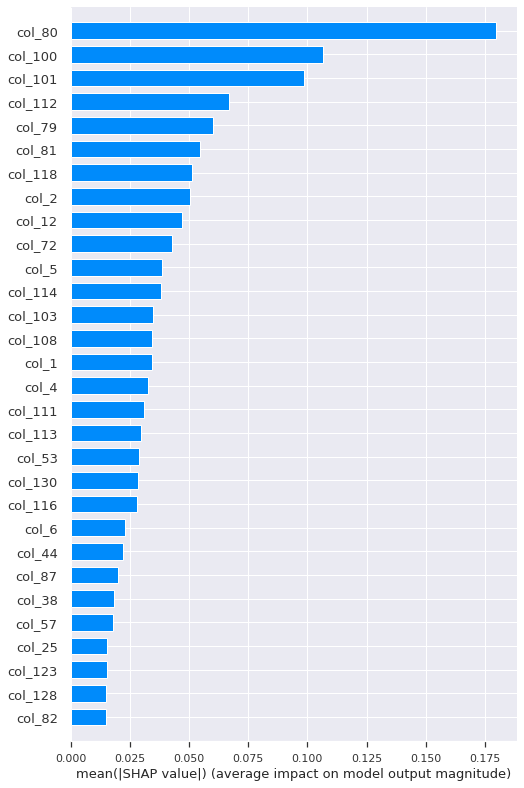

In [36]:
shap.summary_plot(shap_values, X_val[column], plot_type='bar', max_display=30)

# Predict

Do not forget to expose the predict

In [37]:
pred_train = np.expm1(booster.predict(X_train[column]))
pred_val = np.expm1(booster.predict(X_val[column]))
pred_test = np.expm1(booster.predict(test_df[column]))

# Metrics

In [38]:
from sklearn import metrics

# Train

In [39]:
print(metrics.mean_absolute_error(y_train, pred_train))
print(metrics.mean_squared_error(y_train, pred_train))
print(metrics.mean_squared_log_error(y_train, pred_train))
print(metrics.median_absolute_error(y_train, pred_train))

2643.925104335543
10948663.607500242
30.8397720330424
2002.2948947985901


# Val

In [40]:
print(metrics.mean_absolute_error(y_val, pred_val))
print(metrics.mean_squared_error(y_val, pred_val))
print(metrics.mean_squared_log_error(y_val, pred_val))
print(metrics.median_absolute_error(y_val, pred_val))

2662.5385070639404
11191946.333953137
30.87302371402823
2011.5880519873604


# Here you need to highlight the bucket with the business and calculate the metric that is understandable for the business -% of the bucket getting into the bucket. You can also calculate the% hit in the 20% interval.